# Командный проект по сегментации цитологических изображений

## Part №1

Если нет данных библиотек, то уберите # и загрузите

In [1]:
#pip install tensorflow
#pip install stardist
#pip install opencv-python
#pip install csbdeep

In [5]:
import pandas as pd
import numpy as np
import cv2
from matplotlib import pyplot as plt
import os
from PIL import Image
%matplotlib inline
%config InlineBackend.figure_formats = 'retina'
from tqdm import tqdm
from skimage.color import label2rgb
import zipfile

In [3]:
from skimage.color import rgb2gray
from scipy import ndimage
from sklearn.cluster import KMeans
from skimage.filters import sobel
import skimage.segmentation
import warnings
from skimage.feature import peak_local_max
from skimage.segmentation import watershed
warnings.filterwarnings("ignore")

In [4]:
os.getcwd()

'D:\\Python_notebooks\\PAP test'

В процессе выполнения работы кода будет создано несколько отдельных папок. Эти папки используются членами команды для выполнения различных работ по обработке изображений

In [5]:
if not os.path.exists('./Images_no_processing/'):
    os.makedirs("Images_no_processing")

Предстоит работа с клетками шейки матки. Вот как они выглядят в микроскопе:

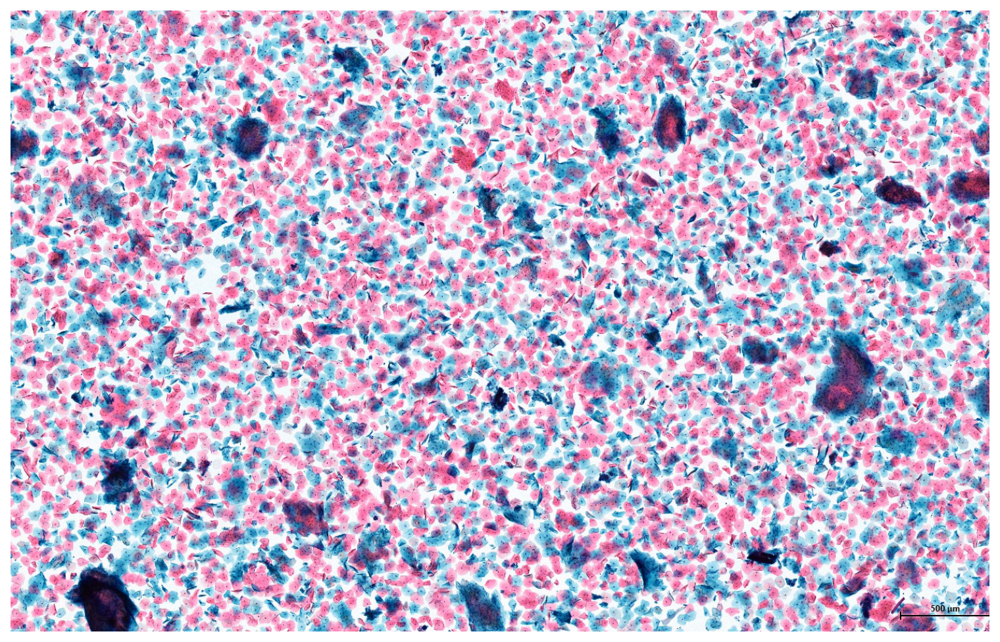

In [6]:
plt.figure(figsize = (12,10), dpi = 80)
image = plt.imread("./Images_no_processing/" + str(34) + ".png",1)
plt.imshow(image)
plt.axis('off')
plt.show()

Мы будем проводить сегметацию данного цитологического препарата, но при большем увеличении

# Предобработка данных

Первоначально в папке *Images_no_processing* лежат фотографии, полученные от лаборантов и врачей ДЦЛИ (Диагностический центр лабораторных исследований департамента здравоохранения города Москвы ) <br/>
Там лежат 25 фотографий с масимальной степенью приближения клеток шейки матки, снятых на микроскопе и еще несколько фотографий с меньшим приближением. Было принято решение исользовать именно те первые 25 фоток для исследований, а фото номер 9 было выбрано опорным - тестовым фото для оценки и сравнения качества семантической и инстнс сегментации. Так что в случае с нейронной сетью stardist именно 24 фотки помимо фото номер 9 выступали в качестве трейновой выборки, а тестовой фоткой стала фотка номер 9.  <br/>
Благодая консультациям врачей из лаборатории ДЦЛИ мы научились самостоятно определять ключевые патологии и с легкостью определять типы клеток на фотографиях, так что самостоятельно занимались разметкой изображений для решения задачи instance сегментации. Для разметки использовали приложение QuPath.


In [7]:
if not os.path.exists('./Images/'):
    os.makedirs("Images")

In [8]:
if not os.path.exists('./Images_for_layout/'):
    os.makedirs("Images_for_layout")

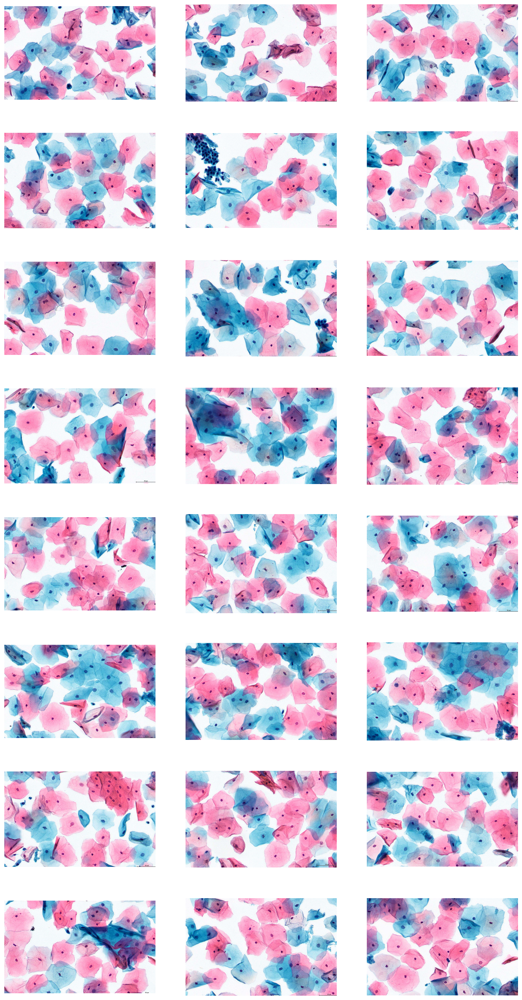

In [9]:
fig, axes = plt.subplots(8, 3, figsize=(15,30))
for i, ax in enumerate(axes.flatten()):
    image = plt.imread("./Images_no_processing/" + str(i+1) + ".png",1)
    ax.imshow(image)
    ax.axis('off')
plt.show()

In [10]:
for filename in os.listdir(".\Images"):
    file_path = os.path.join(".\Images", filename)
    try:
        if os.path.isfile(file_path) or os.path.islink(file_path):
            os.unlink(file_path)
        elif os.path.isdir(file_path):
            shutil.rmtree(file_path)
    except Exception as e:
        print('Failed to delete %s. Reason: %s' % (file_path, e))

In [11]:
size = []
size_h = []
size_w = []
for i in range(1, 26):
    if i<=9:
        name = '0' + str(i)
    else:
        name = str(i)
    image = cv2.imread("./Images_no_processing/" + str(i) + ".png",1)
    im = image[0:800,0:1200]
    cv2.imwrite("./Images/" + name + '.png', im)
    size.append(np.array(image).shape)
    size_h.append(np.array(image).shape[0])
    size_w.append(np.array(image).shape[1])
plt.show()

Папка *Images* создается в процессе выполнения программы для того, чтобы семантическую сегментацию классическими методами без нейронных сетей делать на этих фотках. Данные фотки имеют одинаковый размер - 800:1200

In [12]:
print('Максмальная имеющаяся размерность:', max(size_h), max(size_w))

Максмальная имеющаяся размерность: 918 1425


In [13]:
print('Минимальная имеющаяся размерность:', min(size_h), min(size_w))

Минимальная имеющаяся размерность: 864 1382


Загрузили в папку Images обрезанные фотографии размером 800:1200

In [14]:
sorted(os.listdir(".\Images"))

['01.png',
 '02.png',
 '03.png',
 '04.png',
 '05.png',
 '06.png',
 '07.png',
 '08.png',
 '09.png',
 '10.png',
 '11.png',
 '12.png',
 '13.png',
 '14.png',
 '15.png',
 '16.png',
 '17.png',
 '18.png',
 '19.png',
 '20.png',
 '21.png',
 '22.png',
 '23.png',
 '24.png',
 '25.png']

Обрежем изображения до квадртного размера 800х800 и сожмем до 512х512 пригодных для обучения сверточной нейронной сети. Создадим папку с тренировочным датасетом изображений. Тестовым изображением будет выступать фото №09

(512, 512, 3)

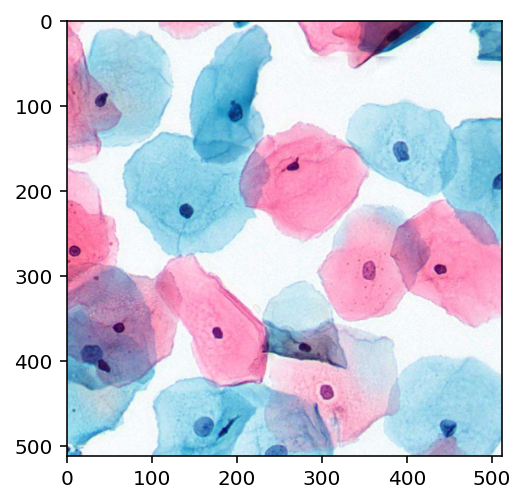

In [15]:
test_im = np.array(Image.open("./Images/" + str('09') + ".png"))
test_im = test_im[0:800,0:800]
test_im = Image.fromarray(test_im)
# downsize the image with an ANTIALIAS filter (gives the highest quality)
test_im = test_im.resize((512,512),Image.ANTIALIAS)
test_im = np.array(test_im)
plt.imshow(test_im)
test_im.shape

In [16]:
for filename in os.listdir(".\Images_for_layout"):
    file_path = os.path.join(".\Images_for_layout", filename)
    try:
        if os.path.isfile(file_path) or os.path.islink(file_path):
            os.unlink(file_path)
        elif os.path.isdir(file_path):
            shutil.rmtree(file_path)
    except Exception as e:
        print('Failed to delete %s. Reason: %s' % (file_path, e))

В папку Images_train положим все фотки кроме 09, приведенные к размеру 512 на 512 пикселей (данный размер выбран для входного слоя сверточной нейронной сети stardist)

In [17]:
sorted(os.listdir(".\Images_for_layout"))

[]

In [18]:
size = []
size_h = []
size_w = []
for i in range(1, 26):
    name = 'w'
    if i < 9:
        name = '0' + str(i)
    if i == 10:
        name = '09'
    if i > 10:
        name = str(i-1)
    k = str(i)
    if i < 10:
        k = '0'+str(i)
    if i != 9: 
        im = np.array(Image.open("./Images/" + k + ".png"))
        im = im[0:800,0:800]
        im = Image.fromarray(im)
        # downsize the image with an ANTIALIAS filter (gives the highest quality)
        im = im.resize((512,512),Image.ANTIALIAS)
        #im = np.array(im)
        im.save("./Images_for_layout/" + name + '.tif')

In [19]:
sorted(os.listdir(".\Images_for_layout"))

['01.tif',
 '02.tif',
 '03.tif',
 '04.tif',
 '05.tif',
 '06.tif',
 '07.tif',
 '08.tif',
 '09.tif',
 '10.tif',
 '11.tif',
 '12.tif',
 '13.tif',
 '14.tif',
 '15.tif',
 '16.tif',
 '17.tif',
 '18.tif',
 '19.tif',
 '20.tif',
 '21.tif',
 '22.tif',
 '23.tif',
 '24.tif']

*Images_train* новая папка, которая создается для того, чтобы 24 фотографии в формате tif можно было задествовать в разметке в приложении QuPath

(512, 512, 3)

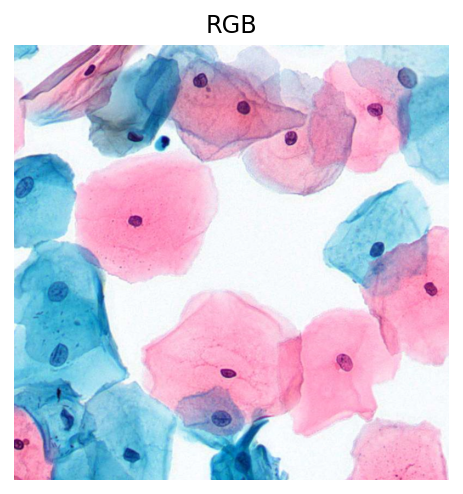

In [20]:
n = '09'
ima = cv2.imread("./Images_for_layout/" + str(n) + ".tif",1)
rgb = cv2.cvtColor(ima, cv2.COLOR_BGR2RGB)
plt.title('RGB')
plt.imshow(rgb);
plt.axis('off');
ima.shape

# Исследование семантической сегментации клеток и ядер на фоне 

Изучим значения по каналам в RGB HSV форматах

(800, 1200, 3)

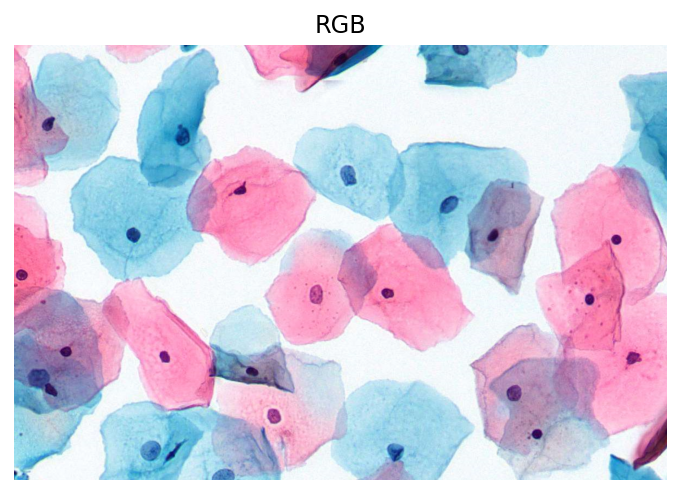

In [21]:
n = '09'
im = cv2.imread("./Images/" + str(n) + ".png",1)
rgb = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
plt.title('RGB')
plt.imshow(rgb);
plt.axis('off')
rgb.shape

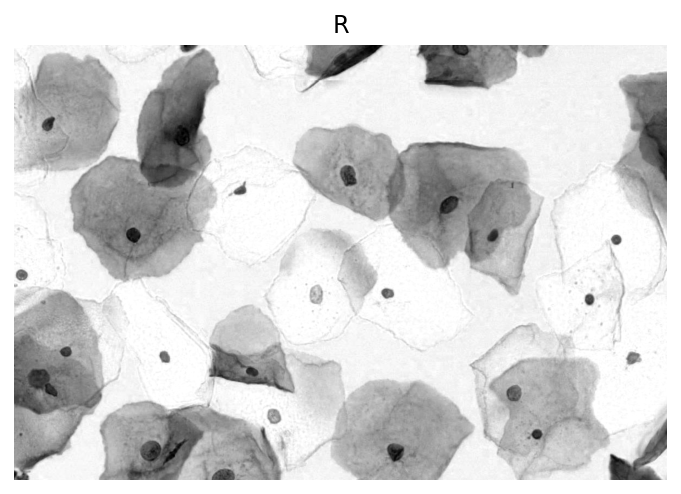

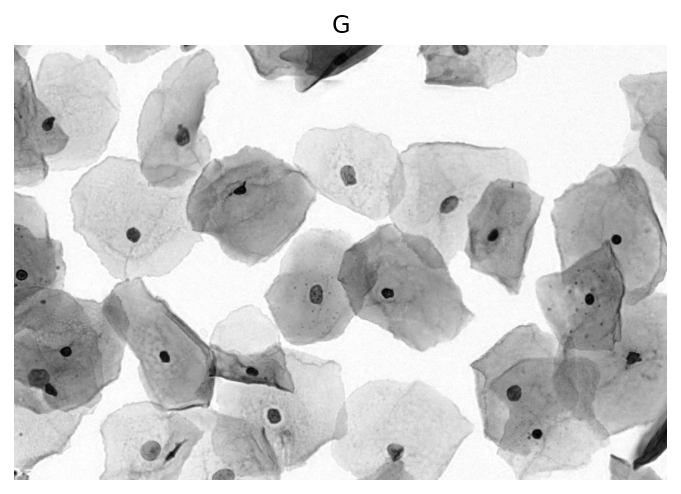

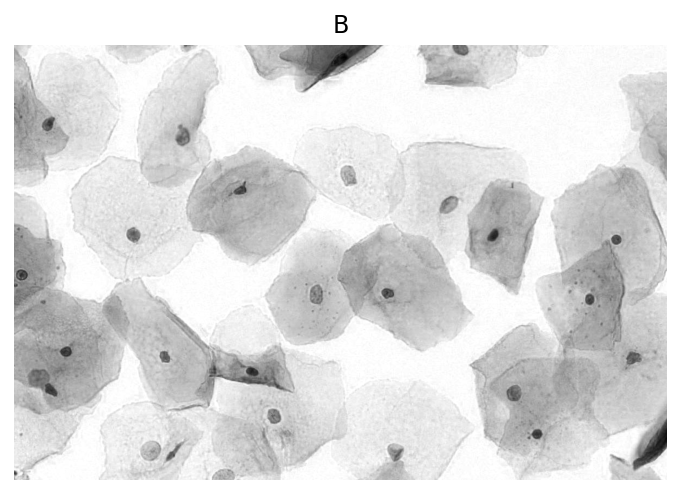

In [22]:
# RGB format
gray = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
plt.imshow(gray[:,:,0], cmap='gray')
plt.axis('off')
plt.title('R')
plt.show()
plt.imshow(gray[:,:,1], cmap='gray')
plt.axis('off')
plt.title('G')
plt.show()
plt.imshow(gray[:,:,2], cmap='gray');
plt.axis('off')
plt.title('B')
plt.show()

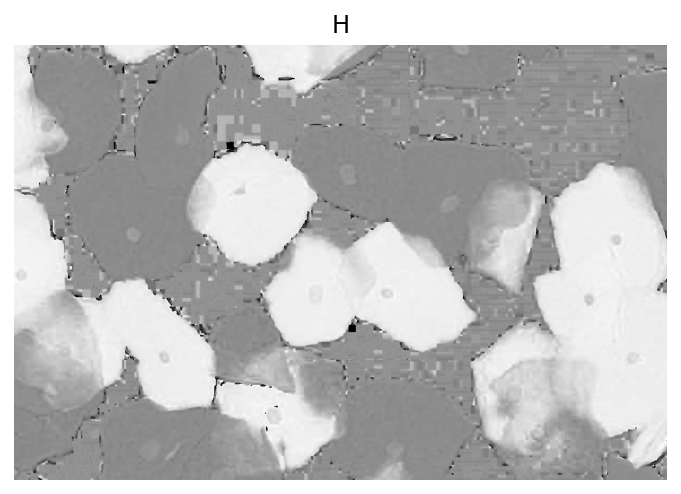

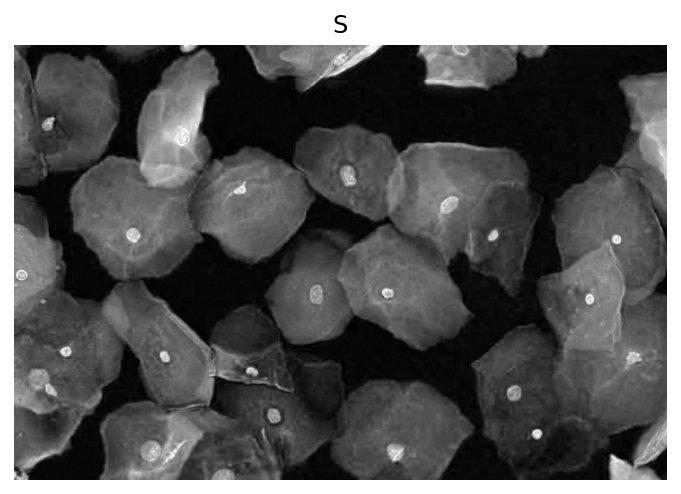

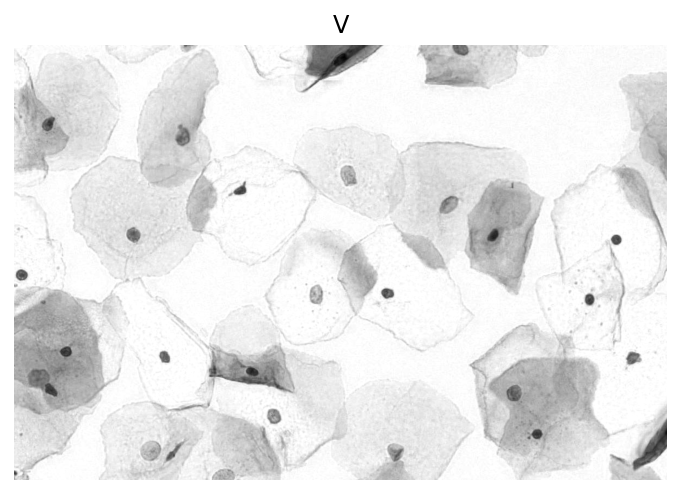

In [23]:
# HSV format
gray = cv2.cvtColor(im, cv2.COLOR_BGR2HSV)
plt.imshow(gray[:,:,0], cmap='gray')
plt.axis('off')
plt.title('H')
plt.show()
plt.imshow(gray[:,:,1], cmap='gray')
plt.axis('off')
plt.title('S')
plt.show()
plt.imshow(gray[:,:,2], cmap='gray')
plt.axis('off')
plt.title('V')
plt.show()

### Методы сегментации на основе значений порогов на гистограмме (пороговая сегментация)

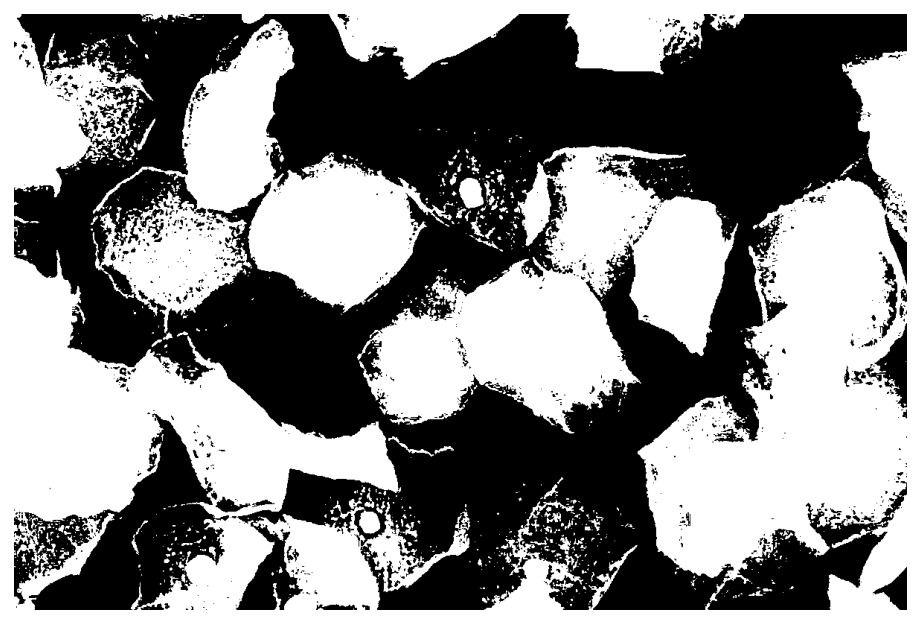

In [24]:
# давайте использовать среднее значение пикселей во всем изображении в качестве порога и использовать его для сегментации
#Создание шкалы серого изображения:
image = Image.open("./Images/" + str(n) + ".png")
image=np.array(image)
gray = rgb2gray(image)
arr=gray.flatten()
plt.figure(figsize=(8,12))
a = gray.copy()
a[a > arr.mean()] = 0
a[(a <= arr.mean()) & (a != 0)] = 1
plt.imshow(a, cmap='gray')
plt.axis("off")
plt.show()

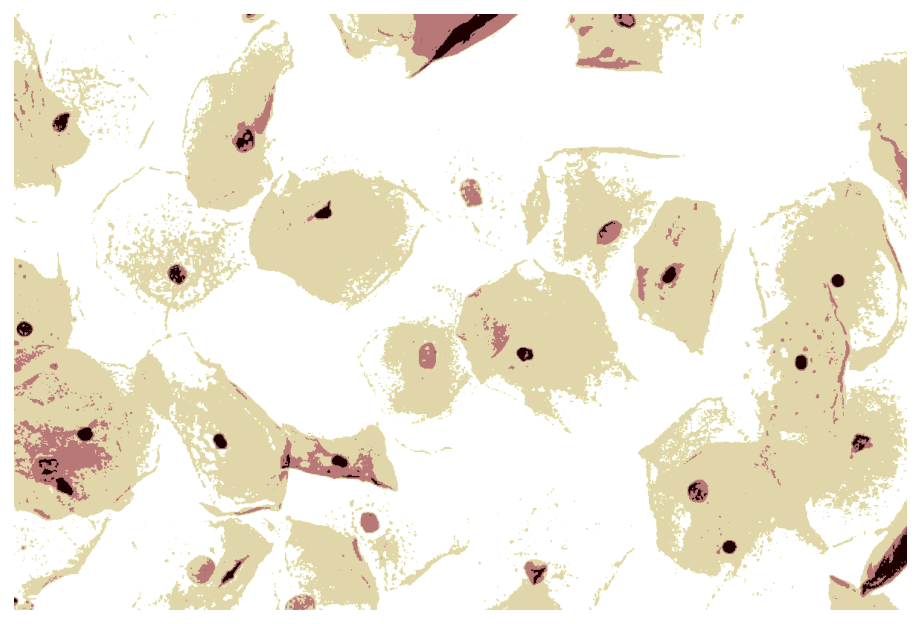

In [25]:
# давайте еще настроим вышеуказанную функцию
a = gray.copy()
a[(a > 0.75)] = 4
a[(a > 0.5) & (a <= 0.75)] = 3
a[(a > 0.25) & (a <= 0.5)] = 2
a[(a < 0.25)] = 1
# На изображении ниже 4 сегмента.
plt.figure(figsize=(8,12))
plt.imshow(a,cmap='pink')
plt.axis("off")
plt.show()

Найдем для серого изображения значение порога по Оцу:

In [26]:
img = cv2.imread("./Images/" + str(n) + ".png",1)
gray_img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

# Set total number of bins in the histogram
bins_num = 256
 
# Get the image histogram
hist, bin_edges = np.histogram(gray_img, bins=bins_num)
 
# Calculate centers of bins
bin_mids = (bin_edges[:-1] + bin_edges[1:]) / 2.
 
# Iterate over all thresholds (indices) and get the probabilities w1(t), w2(t)
weight1 = np.cumsum(hist)
weight2 = np.cumsum(hist[::-1])[::-1]
 
# Get the class means mu0(t)
mean1 = np.cumsum(hist * bin_mids) / weight1
# Get the class means mu1(t)
mean2 = (np.cumsum((hist * bin_mids)[::-1]) / weight2[::-1])[::-1]
 
inter_class_variance = weight1[:-1] * weight2[1:] * (mean1[:-1] - mean2[1:]) ** 2
 
# Maximize the inter_class_variance function val
index_of_max_val = np.argmax(inter_class_variance)
 
threshold = bin_mids[:-1][index_of_max_val]
print("Порог по Оцу равен: ", threshold)

Порог по Оцу равен:  199.927734375


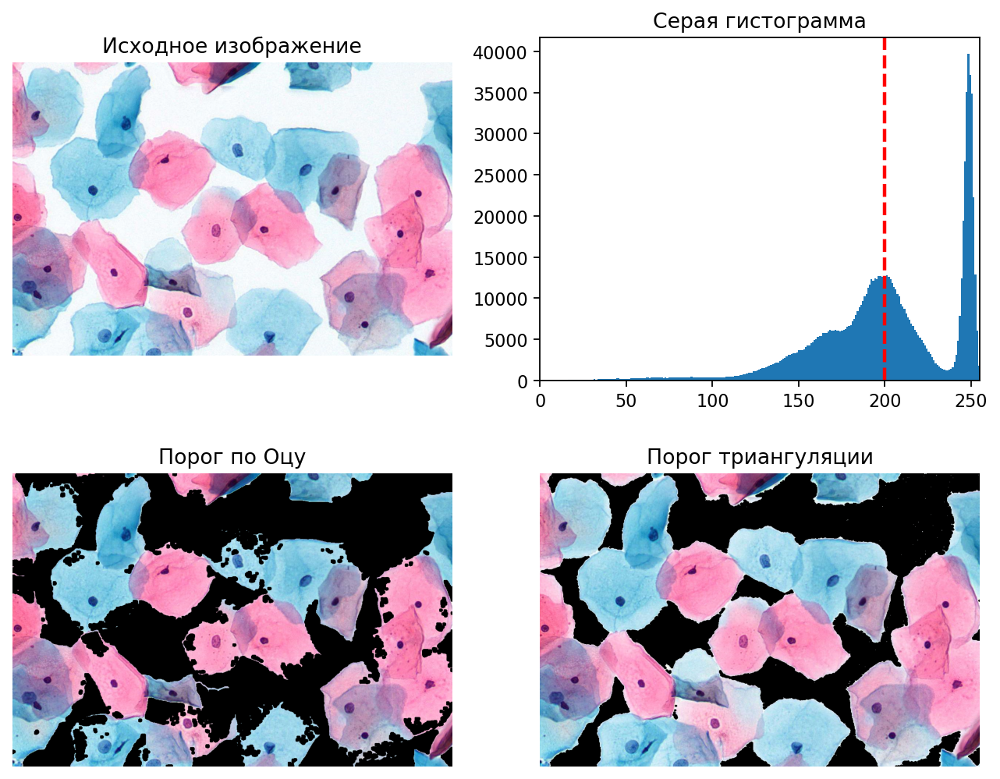

In [27]:
img = cv2.imread("./Images/" + str(n) + ".png",1)
gray_img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

# порог оцу

(t,thresh) = cv2.threshold(gray_img,0,255,cv2.THRESH_TOZERO_INV + cv2.THRESH_OTSU)
thresh_ots = thresh

# Порог триангуляции: порог, определяемый неравномерностью гистограммы.
(t,thresh1) = cv2.threshold(gray_img,0,255,cv2.THRESH_TOZERO_INV + cv2.THRESH_TRIANGLE)
thresh_tr = thresh1

# Морфологические операции
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(10,10))
kernel1 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(7,7))
thresh = cv2.morphologyEx(thresh,cv2.MORPH_CLOSE,kernel)
thresh1 = cv2.morphologyEx(thresh1,cv2.MORPH_CLOSE,kernel1)

# Преобразование цветового пространства: BGR в RGB
img1 = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
result = cv2.cvtColor(cv2.bitwise_and(img, img, mask = thresh), cv2.COLOR_BGR2RGB)
result1 = cv2.cvtColor(cv2.bitwise_and(img, img, mask = thresh1), cv2.COLOR_BGR2RGB)

# Отображение изображения
plt.figure(figsize = (10,8), dpi = 80)
plt.subplot(221)
plt.imshow(img1)
plt.title('Исходное изображение')
plt.axis('off')
plt.subplot(222)
plt.hist(gray_img.flat, bins=255, range = (0,256))
plt.axvline(x=threshold, color='r', linestyle='dashed', linewidth=2)
plt.title('Серая гистограмма')
plt.xlim(0,255)
plt.subplot(223)
plt.imshow(result)
plt.title('Порог по Оцу')
plt.axis('off')
plt.subplot(224)
plt.imshow(result1)
plt.title('Порог триангуляции')
plt.axis('off')
plt.show()

Попрбобуем улучшить результат с порогом по Оцу с помошью морфологических методов (дилактиции и эррозии)

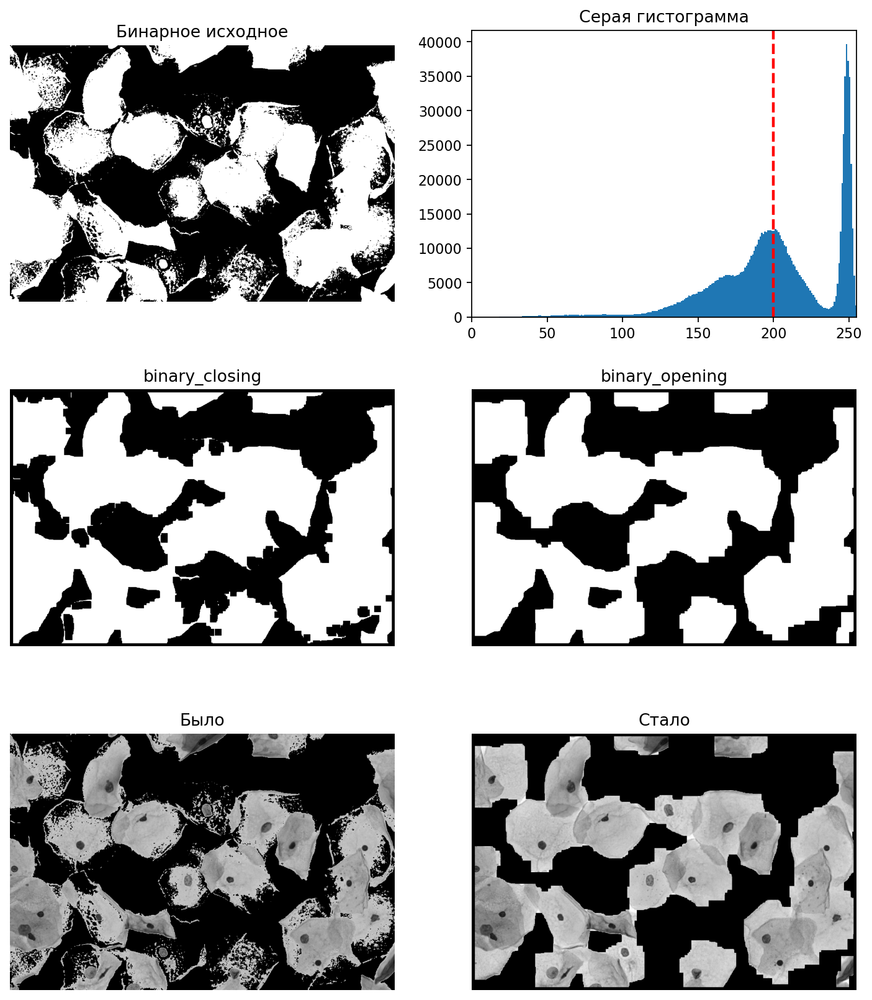

In [28]:
thresh = threshold
plt.figure(figsize = (11,13), dpi = 80)
gray_img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
plt.subplot(321)
a1 = np.array(gray_img)
a1[a1 > thresh] = 0
a1[(a1 <= thresh) & (a1 != 0)] = 255
plt.axis('off')
plt.imshow(a1, cmap='gray')
plt.title("Бинарное исходное")

plt.subplot(322)
plt.hist(gray_img.flat, bins=255, range = (0,256))
plt.axvline(x=threshold, color='r', linestyle='dashed', linewidth=2)
plt.title('Серая гистограмма')
plt.xlim(0,255)


closed = ndimage.binary_closing(a1, structure=np.ones((20,20))).astype(int)
plt.subplot(323)
plt.axis('off')
plt.imshow(closed,cmap='gray')
plt.title("binary_closing")

opened = ndimage.binary_opening(closed, structure=np.ones((35,35))).astype(int)
plt.subplot(324)
plt.axis('off')
plt.imshow(opened,cmap='gray')
plt.title("binary_opening")

plt.subplot(325)
a=np.array(gray_img)
a[a > thresh] = 0
plt.imshow(cv2.cvtColor(a,cv2.COLOR_GRAY2RGB))
plt.axis('off')
plt.title("Было")

plt.subplot(326)
plt.imshow(np.array(gray_img)*opened,cmap='gray')
plt.title("Стало")
plt.axis('off')
plt.show()

Благодаря морфологическим функциям получилось повысить качество бинарной сегментации на фон и область клеток.

Зададим порог по гистограмме равный 235:

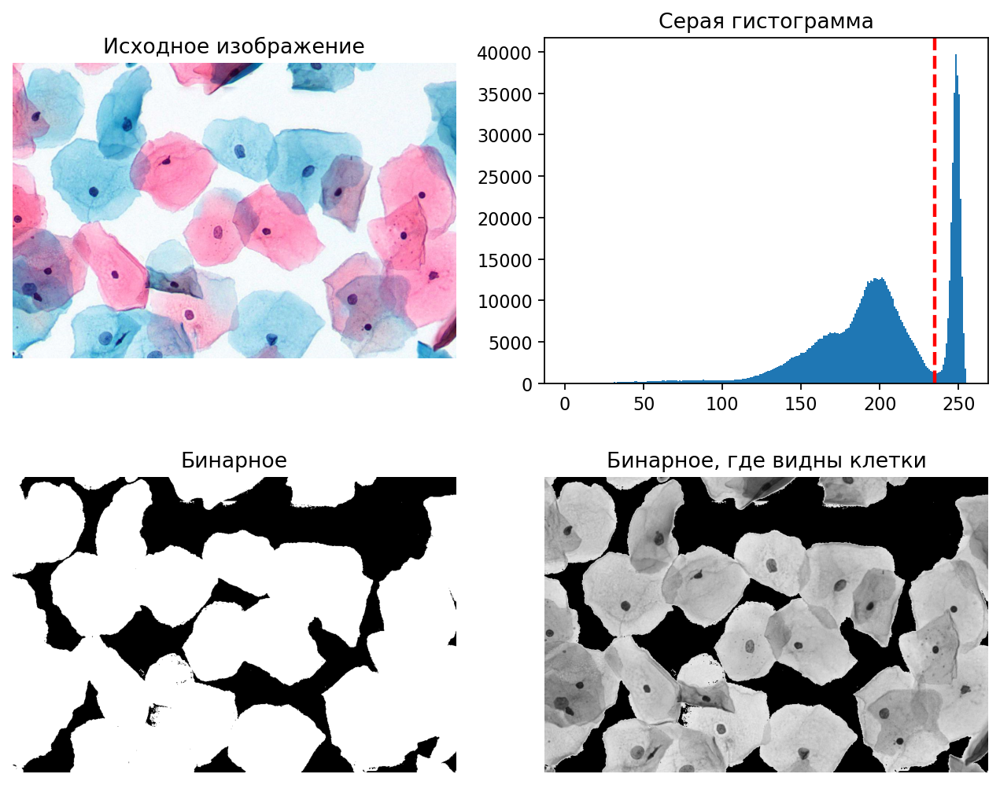

In [29]:
img = cv2.imread("./Images/" + str(n) + ".png",1)
gray_img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
thresh = 235
T, img_binary = cv2.threshold(gray_img, thresh, 255, cv2.THRESH_BINARY_INV)
plt.figure(figsize = (10,8), dpi = 80)
plt.subplot(221)
plt.axis('off');
plt.imshow(img1)
plt.title('Исходное изображение')

plt.subplot(222)
plt.hist(gray_img.flat, bins=255, range = (0,256))
plt.axvline(x=235, color='r', linestyle='dashed', linewidth=2)
plt.title('Серая гистограмма')

plt.subplot(223)
plt.axis('off')
plt.imshow(img_binary, cmap='gray')
plt.title("Бинарное")

a=np.array(gray_img)
a[a > thresh] = 0
plt.subplot(224)
plt.axis('off')
plt.imshow(cv2.cvtColor(a,cv2.COLOR_GRAY2RGB))
plt.title("Бинарное, где видны клетки")
plt.show()

Задавая порог вручную, нам удалось повысить качество по сравнению с вариантом порога по Оцу и морфологическими его измененениями

Рассмотрим пороговую сегментацию изображений в отображении каналов по RGB

In [30]:
img = cv2.imread("./Images/" + str(n) + ".png",1)

def plot_demo(image):
    plt.hist(image.ravel(),256,[0, 256])
    plt.show('Гистограмма')
    
def image_hist(image):
    color = ('blue','green','red')
    for i,color in enumerate(color):
        hist = cv2.calcHist([image],[i],None,[256],[0,256])
        plt.plot(hist, color = color)
        plt.xlim([0,256])
    plt.show()

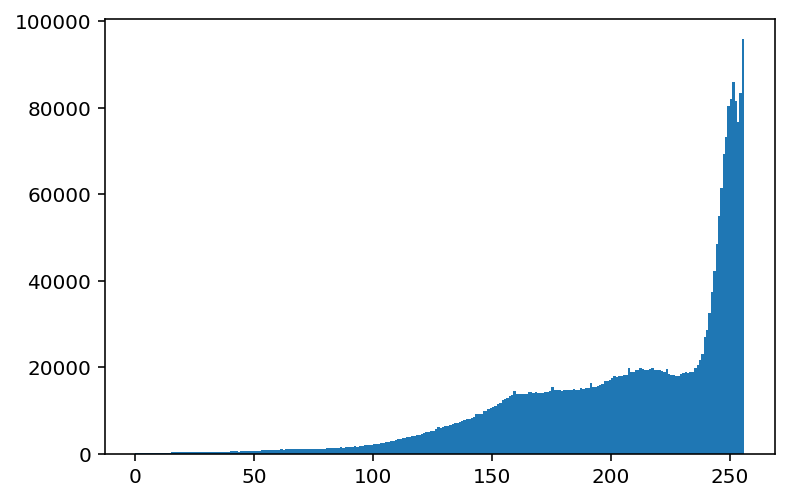

In [31]:
# Гистограмма интенсивностей всех трех цветов (RGB) в одном отображениии
plot_demo(img)

Постоим гистограмму интенсивности RGB каналов:

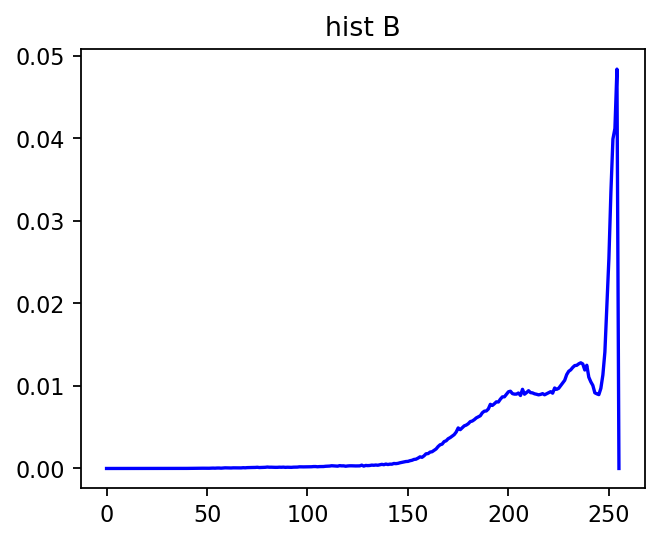

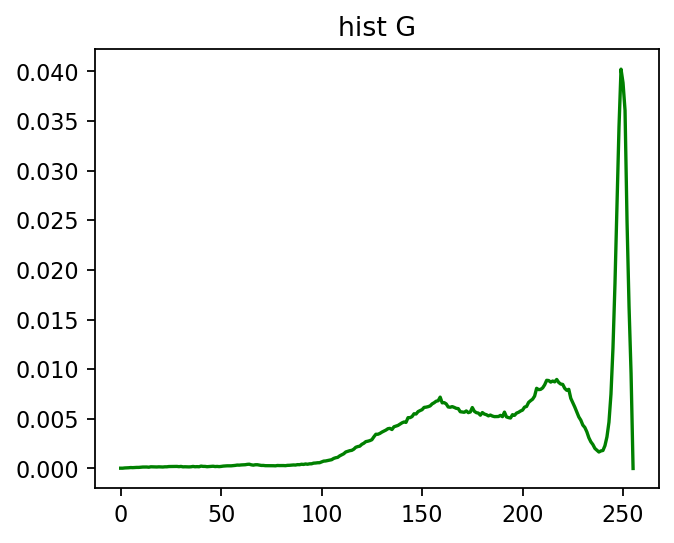

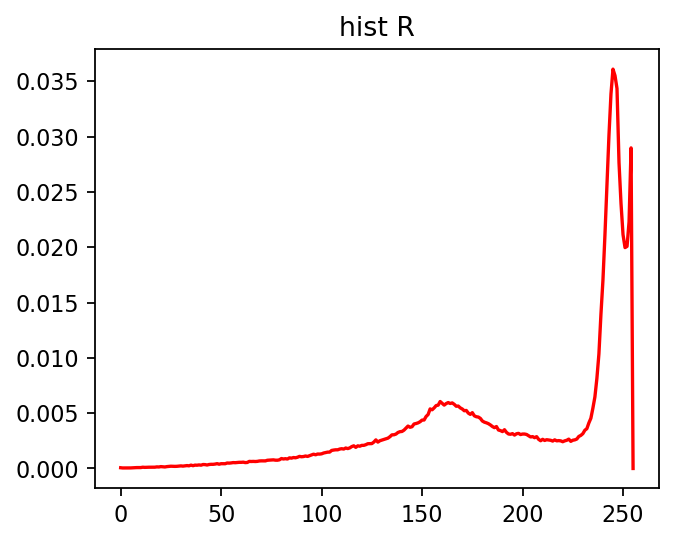

In [32]:
plt.figure(figsize = (10,8), dpi = 80)
hist = cv2.calcHist([img], [0], None, [256], [0, 255])
hist=hist/(img.shape[0]*img.shape[1])
cv2.imshow('img', img)
plt.subplot(221)
plt.plot(hist, color='b')
#|plt.axis('off')
plt.title('hist B')
plt.show()

plt.figure(figsize = (10,8), dpi = 80)
hist = cv2.calcHist([img], [1], None, [256], [0, 255])
hist=hist/(img.shape[0]*img.shape[1])
cv2.imshow('img', img)
plt.subplot(222)
plt.plot(hist, color='g')
#plt.axis('off')
plt.title('hist G')
plt.show()

plt.figure(figsize = (10,8), dpi = 80)
hist = cv2.calcHist([img], [2], None, [256], [0, 255])
hist=hist/(img.shape[0]*img.shape[1])
cv2.imshow('img', img)
plt.subplot(223)
plt.plot(hist, color='r')
#plt.axis('off')
plt.title('hist R')
plt.show()

Проведем пороговую сегментацию в HSV преображении данных

Поиск мест пересечения клеток разных цветов:

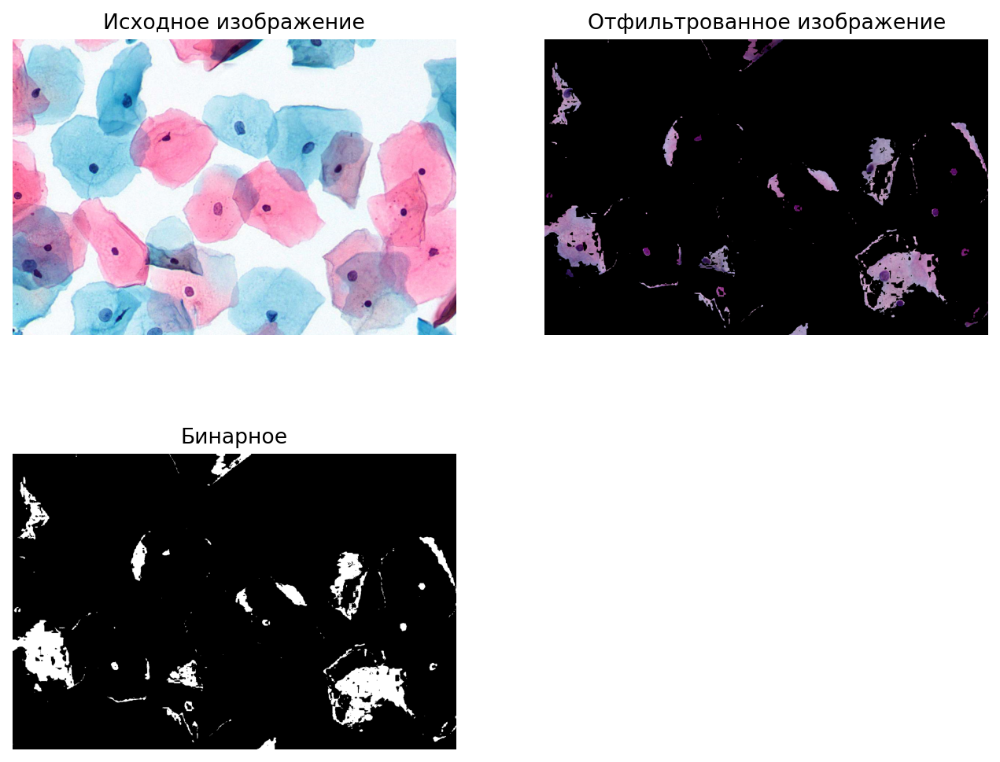

In [33]:
img = cv2.imread("./Images/" + str(n) + ".png",1)
RGBimg = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
 
hsv = cv2.cvtColor (img, cv2.COLOR_BGR2HSV) 
lower_intersection = np.array ([125, 43, 46]) # Диапазон пикселей, который будет обнаружен
upper_intersection = np.array ([155, 255, 255]) # определить цветовую зону
mask = cv2.inRange(hsv, lowerb=lower_intersection, upperb=upper_intersection)
res_intersection = cv2.bitwise_and(RGBimg, RGBimg, mask = mask)

# Делаем бинарное
res_intersection_2 = cv2.cvtColor(res_intersection, cv2.COLOR_HSV2BGR)
gray = cv2.cvtColor(res_intersection_2, cv2.COLOR_BGR2GRAY)
thresh = 40
T, img_binary = cv2.threshold(gray, thresh, 255, cv2.THRESH_BINARY)

plt.figure(figsize = (10,8), dpi = 80)

plt.subplot(221)
plt.axis('off');
plt.imshow(RGBimg)
plt.title('Исходное изображение')


plt.subplot(222)
plt.axis('off')
plt.imshow(res_intersection)
plt.title('Отфильтрованное изображение');

plt.subplot(223)
plt.axis('off')
plt.imshow(img_binary, cmap='gray')
plt.title("Бинарное")
plt.show()

Места клеток синих цветов:

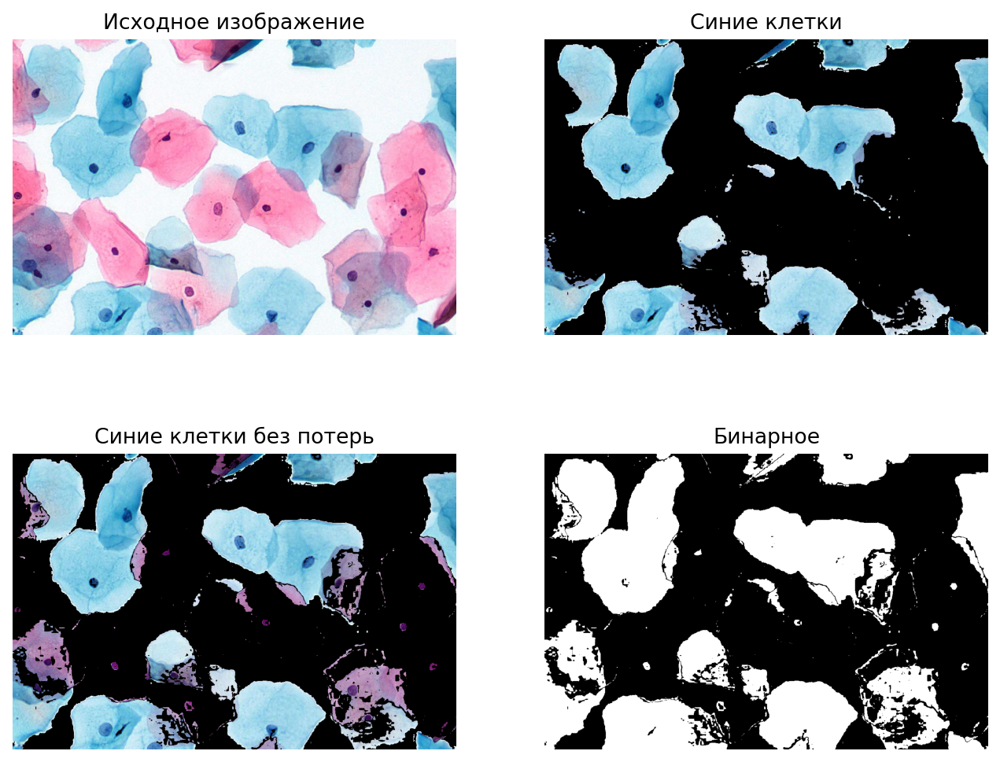

In [34]:
img = cv2.imread("./Images/" + str(n) + ".png", 1)
RGBimg = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
 
hsv = cv2.cvtColor (img, cv2.COLOR_BGR2HSV) 
lower_blue = np.array ([80, 20, 50]) # Диапазон пикселей, который будет обнаружен
upper_blue = np.array ([110, 255, 255]) # определить цветовую зону
mask = cv2.inRange(hsv, lowerb = lower_blue, upperb = upper_blue)
res_blue = cv2.bitwise_and(RGBimg, RGBimg, mask = mask)

#Дополняем потерянные куски синих клеток с помощью добавления мест пересечений
res_together = cv2.add(res_blue, res_intersection) 

# Делаем бинарное
res_together_2 = cv2.cvtColor(res_together, cv2.COLOR_HSV2BGR)
gray = cv2.cvtColor(res_together_2, cv2.COLOR_BGR2GRAY)
thresh = 45
T, img_binary = cv2.threshold(gray, thresh, 255, cv2.THRESH_BINARY)

# Вывод данных

plt.figure(figsize = (10,8), dpi = 80)

plt.subplot(221)
plt.axis('off');
plt.imshow(RGBimg)
plt.title('Исходное изображение')


plt.subplot(222)
plt.axis('off')
plt.imshow(res_blue)
plt.title("Синие клетки")

plt.subplot(223)
plt.axis('off')
plt.imshow(res_together)
plt.title("Синие клетки без потерь")

plt.subplot(224)
plt.axis('off')
plt.imshow(img_binary, cmap='gray')
plt.title("Бинарное")
plt.show()

Места клеток красных цветов:

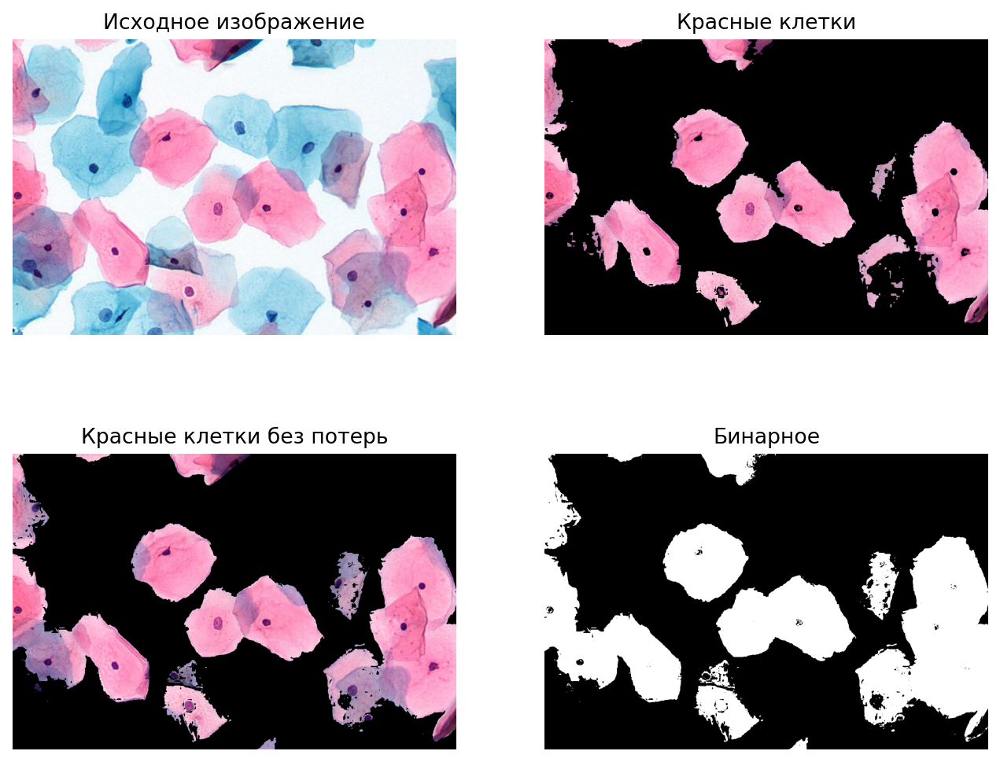

In [35]:
img = cv2.imread("./Images/" + str(n) + ".png")
RGBimg = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
 
hsv = cv2.cvtColor (img, cv2.COLOR_BGR2HSV) 
lower_red = np.array ([156, 43, 46]) # Диапазон пикселей, который будет обнаружен
upper_red = np.array ([180, 255, 255]) # определить цветовую зону
mask = cv2.inRange(hsv, lowerb = lower_red, upperb = upper_red)
res_red = cv2.bitwise_and(RGBimg, RGBimg, mask= mask)

#Дополняем потерянные куски синих клеток с помощью добавления мест пересечений
res_together = cv2.add(res_red, res_intersection) 

# Делаем бинарное
res_together_2 = cv2.cvtColor(res_together, cv2.COLOR_HSV2BGR)
gray = cv2.cvtColor(res_together_2, cv2.COLOR_BGR2GRAY)
thresh = 90
T, img_binary = cv2.threshold(gray, thresh, 255, cv2.THRESH_BINARY)


#ret, threshold = cv2.threshold(gray, 120, 255, 0)

plt.figure(figsize = (10,8), dpi = 80)

plt.subplot(221)
plt.axis('off');
plt.imshow(RGBimg)
plt.title('Исходное изображение')


plt.subplot(222)
plt.axis('off')
plt.imshow(res_red)
plt.title('Красные клетки')

plt.subplot(223)
plt.axis('off')
plt.imshow(res_together)
plt.title("Красные клетки без потерь")

plt.subplot(224)
plt.axis('off')
plt.imshow(img_binary, cmap='gray')
plt.title("Бинарное")
plt.show()

Находим ядра:

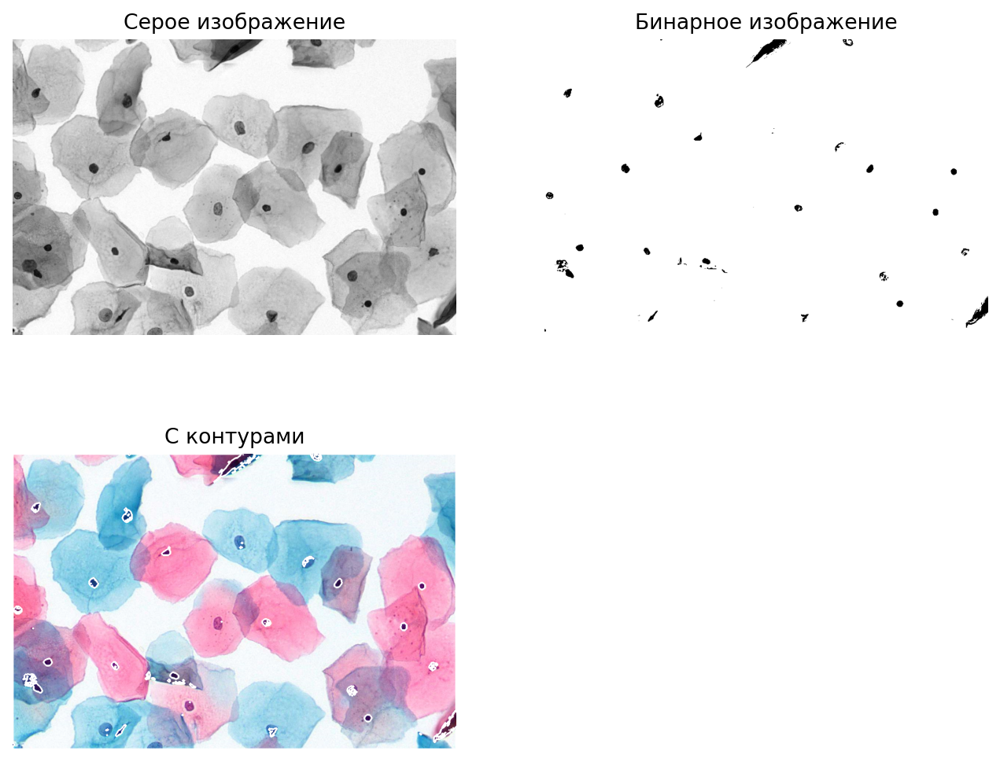

In [36]:
image = cv2.imread("./Images/" + str(n) + ".png",1)
RGB_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
hsv_img = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

# Делаем серое изображение
gray = cv2.cvtColor(RGB_image, cv2.COLOR_RGB2GRAY)

# Делаем бинарное
ret, threshold = cv2.threshold(gray, 70, 255, 0)

# Делаем контур
contours, hierarchy = cv2.findContours(threshold,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
cv2.drawContours(RGB_image, contours, -1, (255, 255, 255), 3)

# Вывод данных
plt.figure(figsize = (10,8), dpi = 80)

plt.subplot(221)
plt.imshow(gray, cmap='gray')
plt.title('Серое изображение')
plt.axis('off')

plt.subplot(222)
plt.imshow(threshold, cmap='gray')
plt.title('Бинарное изображение')
plt.axis('off')

plt.subplot(223)
plt.imshow(RGB_image)
plt.title('С контурами')
plt.axis('off')
plt.show()

### __Продолжение смотри в файле [segmentation_part_2](https://github.com/Koldim2001/Segmentation_cells-nuclei/blob/main/segmentation_part_2.ipynb)__